# Covid19 - Brazil (Cities) Basic Geographic Analysis
- by Marcelo Rovai
- 09 May 2020

## Main Libraries and setup

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import plotly
import plotly.graph_objs as go
import geopandas as gpd
from shapely.geometry import Point, Polygon
from unicodedata import normalize
from PIL import Image

In [2]:
import imageio

In [3]:
from cv_util_func import *

In [4]:
import warnings
warnings.filterwarnings("ignore")

In [5]:
pd.set_option('display.float_format', lambda x: '%.f' % x)
pd.options.display.float_format = '{:,}'.format
mpl.rcParams['figure.dpi']= 150
plt.style.use('seaborn-paper')

## Datasets

### Worldometers Daily Data

- Based on TDS article: [Track Coronavirus in Your Country by Displaying Notifications Using Python](https://towardsdatascience.com/coronavirus-track-coronavirus-in-your-country-by-displaying-notification-c914b5652088)

In [6]:
worldmetersLink = "https://www.worldometers.info/coronavirus/"

In [7]:
_, _ = get_wordometers_covid('World', worldmetersLink)
_, _ = get_wordometers_covid('USA', worldmetersLink)
_, _ = get_wordometers_covid('India', worldmetersLink)
_, _ = get_wordometers_covid('Russia', worldmetersLink)
_, _ = get_wordometers_covid('Chile', worldmetersLink)
_, _ = get_wordometers_covid('Mexico', worldmetersLink)


World - Worldometers Daily Data

Today is 2020-05-10 11:27:53.582146 
- Total infected = 4.134.921 
- New Cases = 36.642 
- Total Deaths = 281.174 
- New Deaths = 950 
- Recovered = 1.455.719 
- Active Cases = 2.398.028 
- Serious-Critical = 47.444

USA - Worldometers Daily Data

Today is 2020-05-10 11:27:55.689143 
- Total infected = 1.350.194 
- New Cases = 2.885 
- Total Deaths = 80.121 
- New Deaths = 84 
- Recovered = 238.144 
- Active Cases = 1.031.929 
- Serious-Critical = 16.816

India - Worldometers Daily Data

Today is 2020-05-10 11:27:57.674286 
- Total infected = 65.021 
- New Cases = 2.213 
- Total Deaths = 2.153 
- New Deaths = 52 
- Recovered = 19.665 
- Active Cases = 43.203 
- Serious-Critical = 0

Russia - Worldometers Daily Data

Today is 2020-05-10 11:27:59.756268 
- Total infected = 209.688 
- New Cases = 11.012 
- Total Deaths = 1.915 
- New Deaths = 88 
- Recovered = 34.306 
- Active Cases = 173.467 
- Serious-Critical = 2.300

Chile - Worldometers Daily Data

T

In [54]:
data_wd_covid_br, today = get_wordometers_covid('Brazil', worldmetersLink)
# Saving Brazil info
Total_infected = data_wd_covid_br[0]
New_Cases = data_wd_covid_br[1]
Total_Deaths = data_wd_covid_br[2]
New_Deaths = data_wd_covid_br[3] 
Recovred = data_wd_covid_br[4] 
Active_Case = data_wd_covid_br[5] 
Serious_Critical = data_wd_covid_br[6]
date = today


Brazil - Worldometers Daily Data

Today is 2020-05-12 13:49:20.385891 
- Total infected = 172.243 
- New Cases = 3.100 
- Total Deaths = 11.980 
- New Deaths = 355 
- Recovered = 67.384 
- Active Cases = 92.879 
- Serious-Critical = 8.318


### Covid19

Confirmed cases by day, using information from the news. Covid19br dataset is available at GitHub https://github.com/wcota/covid19br, with data by city compiled from original dataset provided by [Brasil.IO](https://brasil.io/dataset/covid19/caso/). <br>
Thanks to: 
- [Wesley Cota](https://wesleycota.com), PhD candidate - Complex Networks/Physics (Universidade Federal de Viçosa - Brazil and Universidad de Zaragoza - Spain) 
- [Alvaro Justen](https://blog.brasil.io/author/alvaro-justen.html) from [Brasil.IO](https://brasil.io/dataset/covid19/caso/).

License: [Creative Commons Attribution-ShareAlike 4.0 International (CC BY-SA 4.0)](https://creativecommons.org/licenses/by-sa/4.0/)

More information: https://wcota.me/covid19br and [ESPECIAL COVID-19 - Dados por Município](https://brasil.io/covid19/)

**Number of total cases by city** 

In [55]:
dt, dt_tm, dt_tm_city, dt_state, total_cases, deaths, cfr = get_brazil_cv_data(
    date)


Today is 2020/5/12. Dataset with 2964 observations.


Total number of cases in Brasil at 5/12: 169,649 (11660 fatal) with a CFR of 6.87%


**Total cases by state**

In [56]:
dt_state.sort_values('deaths', ascending=False)

,state,deaths,totalCases,CFR[%]
25,SP,3743,46131,8.11
18,RJ,1770,17939,9.87
5,CE,1189,17599,6.76
15,PE,1087,13768,7.9
2,AM,1035,12919,8.01
13,PA,812,8069,10.06
9,MA,423,8526,4.96
4,BA,214,5816,3.68
7,ES,196,4819,4.07
14,PB,139,2525,5.5


### Used for development only

In [127]:
n_0 = 1000
mov = 7
city = 'TOTAL'
data = dt_tm
data = data[data.city == city]
tst = data[data.totalCases >= n_0]
tst.reset_index(drop=True, inplace = True)

In [129]:
tst['new_deaths'] = tst['deaths'] - tst['deaths'].shift(1)

In [130]:
tst.head()

,date,country,state,city,ibgeID,newDeaths,deaths,newCases,totalCases,deaths_per_100k_inhabitants,totalCases_per_100k_inhabitants,deaths_by_totalCases,new_deaths
0,2020-03-21,Brazil,TOTAL,TOTAL,0,7,18,225,1197,0.00857,0.5696,0.015040000000000001,nan
1,2020-03-22,Brazil,TOTAL,TOTAL,0,7,25,397,1594,0.0119,0.75852,0.01568,7.0
2,2020-03-23,Brazil,TOTAL,TOTAL,0,9,34,359,1952,0.01618,0.9288700000000001,0.017419999999999998,9.0
3,2020-03-24,Brazil,TOTAL,TOTAL,0,13,47,303,2255,0.022369999999999998,1.0730600000000001,0.02084,13.0
4,2020-03-25,Brazil,TOTAL,TOTAL,0,12,59,311,2566,0.02808,1.22105,0.02299,12.0


In [131]:
tst['new_deaths_Mov_Ave'] = tst.iloc[:, -1].rolling(window=mov).mean()
tst['mov_ave_new_deaths_last_week'] = tst['new_deaths_Mov_Ave'] - tst['new_deaths_Mov_Ave'].shift(7)

In [132]:
tst.head(20)

,date,country,state,city,ibgeID,newDeaths,deaths,newCases,totalCases,deaths_per_100k_inhabitants,totalCases_per_100k_inhabitants,deaths_by_totalCases,new_deaths,new_deaths_Mov_Ave,mov_ave_new_deaths_last_week
0,2020-03-21,Brazil,TOTAL,TOTAL,0,7,18,225,1197,0.00857,0.5696,0.015040000000000001,nan,nan,nan
1,2020-03-22,Brazil,TOTAL,TOTAL,0,7,25,397,1594,0.0119,0.75852,0.01568,7.0,nan,nan
2,2020-03-23,Brazil,TOTAL,TOTAL,0,9,34,359,1952,0.01618,0.9288700000000001,0.017419999999999998,9.0,nan,nan
3,2020-03-24,Brazil,TOTAL,TOTAL,0,13,47,303,2255,0.022369999999999998,1.0730600000000001,0.02084,13.0,nan,nan
4,2020-03-25,Brazil,TOTAL,TOTAL,0,12,59,311,2566,0.02808,1.22105,0.02299,12.0,nan,nan
5,2020-03-26,Brazil,TOTAL,TOTAL,0,18,77,424,2990,0.03664,1.4228100000000001,0.02575,18.0,nan,nan
6,2020-03-27,Brazil,TOTAL,TOTAL,0,16,93,487,3476,0.04425,1.65408,0.02675,16.0,nan,nan
7,2020-03-28,Brazil,TOTAL,TOTAL,0,22,115,479,3955,0.054720000000000005,1.88201,0.02908,22.0,13.857142857142858,nan
8,2020-03-29,Brazil,TOTAL,TOTAL,0,22,137,358,4313,0.06519,2.0523700000000002,0.031760000000000004,22.0,16.0,nan
9,2020-03-30,Brazil,TOTAL,TOTAL,0,29,166,358,4663,0.07899,2.2189200000000002,0.0356,29.0,18.857142857142858,nan


### Timeline Brazil

In [11]:
plot_cases(dt_tm, 'TOTAL', y_scale='linear', n_0=1000, mov=7, show=True, save=False)

In [12]:
plot_cases(dt_tm, 'TOTAL', y_scale='log', n_0=1000, mov=7, show=True, save=False)

In [70]:
plot_cases(dt_tm, 'Teresina/PI', y_scale='log', n_0=20, mov=7, show=True, save=False)

**Timeline of cases per city**

In [58]:
top_cities = list(dt.sort_values('totalCases', ascending=False)[:10].city)
top_cities

['São Paulo/SP',
 'Fortaleza/CE',
 'Rio de Janeiro/RJ',
 'Manaus/AM',
 'Recife/PE',
 'São Luís/MA',
 'Salvador/BA',
 'Belém/PA',
 'Brasília/DF',
 'Macapá/AP']

In [ ]:
for city in top_cities:
    plot_cases(dt_tm, city, y_scale='linear', n_0=100, mov=7, show=True, save=False)
    plot_cases(dt_tm, city, y_scale='log', n_0=100, mov=7, show=True, save=False) 

## Timeline New Deaths versus Previus Week 

In [44]:
def plot_mov_ave_deaths_last_week(data,
                                  city,
                                  n_0=100,
                                  y_scale='log',
                                  mov=7,
                                  graph='bar',
                                  show=False,
                                  save=True):
    date = datetime.datetime.today()
    data = data[data.city == city]
    tst = data[data.deaths >= n_0]
    tst.reset_index(drop=True, inplace=True)

    tst['new_deaths'] = tst['deaths'] - tst['deaths'].shift(1)
    tst['new_deaths_Mov_Ave'] = tst.iloc[:, -1].rolling(window=mov).mean()
    tst['mov_ave_new_deaths_last_week'] = tst['new_deaths_Mov_Ave'] - tst[
        'new_deaths_Mov_Ave'].shift(7)
    fig = go.Figure()
    if graph == 'bar':
        fig.add_trace(
            go.Bar(x=tst.date,
                   y=round(tst.new_deaths_Mov_Ave),
                   name='New Deaths'))
        fig.add_trace(
            go.Bar(x=tst.date,
                   y=round(tst.mov_ave_new_deaths_last_week),
                   name='New Deaths vs last week'))
    else:
        fig.add_trace(
            go.Scatter(x=tst.date,
                       y=round(tst.new_deaths_Mov_Ave),
                       name='New Daily Deaths',
                       line=dict(color='royalblue', width=2)))
        fig.add_trace(
            go.Scatter(x=tst.date,
                       y=round(tst.mov_ave_new_deaths_last_week),
                       name='New Deaths vs last week',
                       line=dict(color='firebrick', width=2)))
    fig.update_layout(
        title=
        'Brazil ({}) - New Deaths by Covid-19 versus same day previous week'.
        format(city),
        xaxis_title="Day",
        yaxis_title="Number of Deaths",
        yaxis_type=y_scale,
        font=dict(size=10, color="#7f7f7f"),
        legend=dict(x=0,
                    y=1.0,
                    bgcolor='rgba(255, 255, 255, 0)',
                    bordercolor='rgba(255, 255, 255, 0)'),
        annotations=[
            dict(
                x=0,
                y=1.05,
                text=
                'Deaths over {:,} - Y-scale: {} ({}-day rolling average) - {}/{}/{}'
                .format(n_0, y_scale, mov, date.year, date.month, date.day),
                showarrow=False,
                xref='paper',
                yref='paper',
                xanchor='left',
                yanchor='auto',
                xshift=0,
                yshift=0,
                font=dict(size=10, color="#7f7f7f")),
            dict(x=1,
                 y=-0.10,
                 text=
                 "Source: Brasil.io - https://brasil.io/dataset/covid19/caso/",
                 showarrow=False,
                 xref='paper',
                 yref='paper',
                 xanchor='right',
                 yanchor='auto',
                 xshift=0,
                 yshift=0,
                 font=dict(size=8, color='royalblue')),
            dict(x=1,
                 y=-0.14,
                 text="Created by Marcelo Rovai - https://MJRoBot.org",
                 showarrow=False,
                 xref='paper',
                 yref='paper',
                 xanchor='right',
                 yanchor='auto',
                 xshift=0,
                 yshift=0,
                 font=dict(size=8, color='royalblue'))
        ])

    if save == True:
        city = city.replace('/', '-')
        fig.write_image(
            '../graphs/cv19_' + city + '_' + y_scale +
            '_CV_Mov_ave_deaths_last_week_Evolution_Graph_updated.png')
    if show == True:
        fig.show()

    return tst

In [53]:
tst = plot_mov_ave_deaths_last_week(dt_tm, 'TOTAL', y_scale='linear', n_0=100, mov=7, show=True, save=False)

In [51]:
tst = plot_mov_ave_deaths_last_week(dt_tm, 'São Paulo/SP', y_scale='linear', n_0=3, mov=7, graph='line', show=True, save=False)

In [60]:
tst = plot_mov_ave_deaths_last_week(dt_tm, 'Teresina/PI', y_scale='linear', n_0=3, mov=7, graph='bar', show=True, save=False)

In [37]:
tst.head(2)

,date,country,state,city,ibgeID,newDeaths,deaths,newCases,totalCases,deaths_per_100k_inhabitants,totalCases_per_100k_inhabitants,deaths_by_totalCases,new_deaths,new_deaths_Mov_Ave,mov_ave_new_deaths_last_week
0,2020-03-18,Brazil,TOTAL,TOTAL,0,3,4,191,514,0.0019,0.24459,0.00778,nan,nan,nan
1,2020-03-19,Brazil,TOTAL,TOTAL,0,3,7,134,639,0.0033299999999999996,0.30407,0.01095,3.0,nan,nan


In [38]:
file = '../data/20_Covid_Database_Brazil/cv19_Brazil_Time_Line_Deaths_Mov_Ave.xlsx'
tst.to_excel(file)

In [ ]:
for city in top_cities:
    tst = plot_mov_ave_deaths_last_week(dt_tm, city, y_scale='linear', n_0=3, mov=7, show=True, save=False)

### GeoData (Brasil & Municipalities)

### GeoData (Brasil & Municipalities)

In [ ]:
br_shp, br_cities = load_geodata()

## Maping CoronaVirus data

### Nationwide Analysis

In [16]:
date = datetime.datetime.today()
cv_city, deaths_city, cv_city_pnt, deaths_city_pnt, total_cases, deaths, cfr = get_Brazil_data(dt, br_shp, br_cities)

Brazil: Total number of Covid19 cases at 5/10: 157,231 (10,695 fatal) in 2,814 cities with a CFR of 6.8%


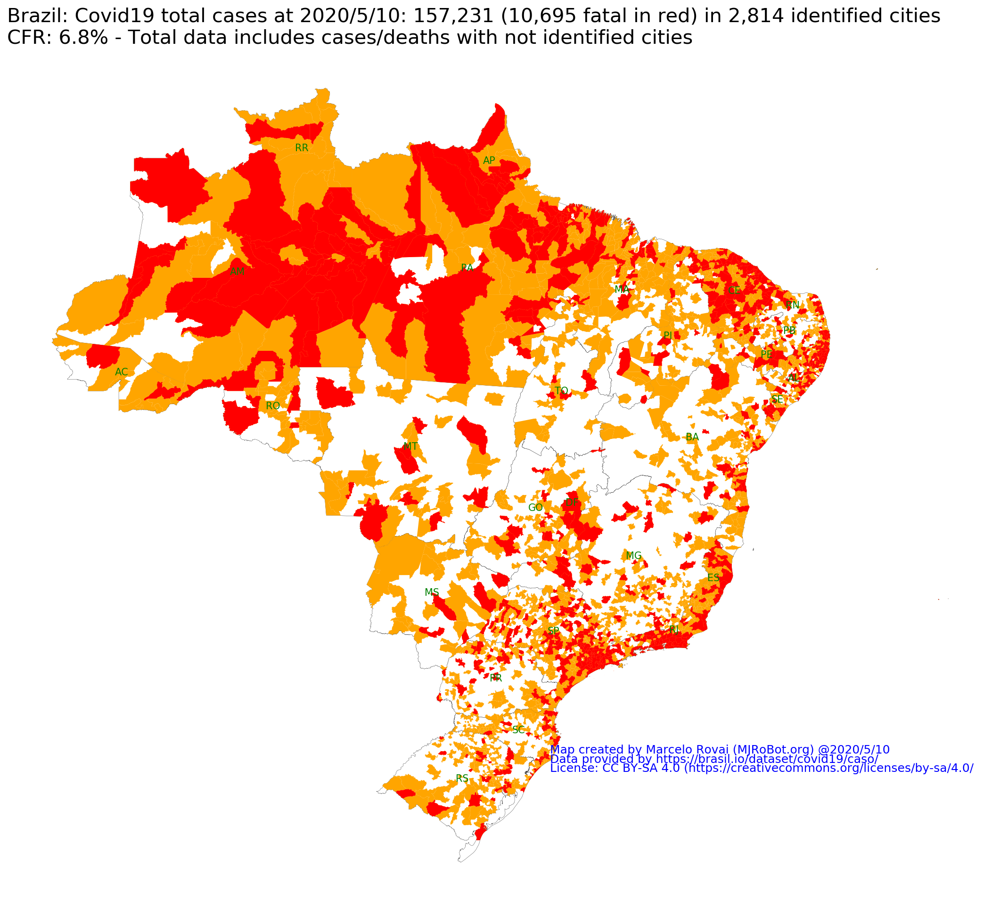

In [17]:
plt_Brasil_cities(cv_city, deaths_city, date, total_cases, deaths, cfr, br_shp, br_cities, deaths_only=False)

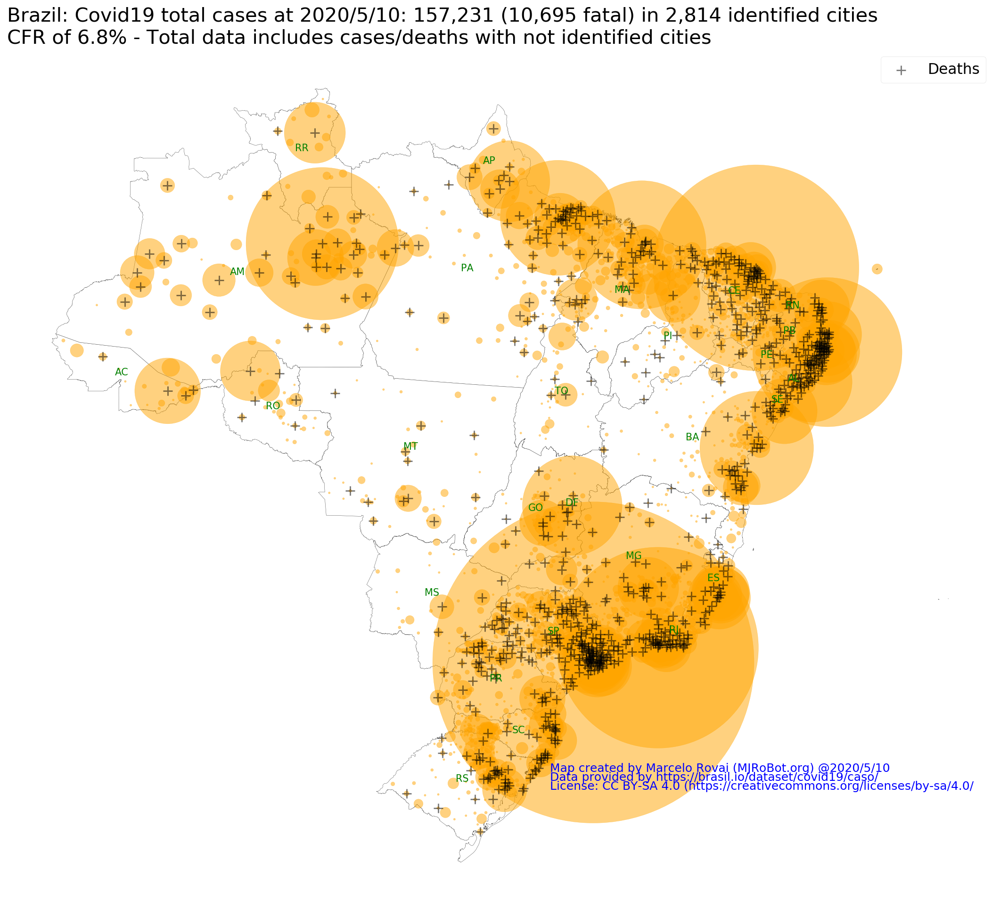

In [18]:
plt_Brasil_cv_metrics(cv_city_pnt, deaths_city_pnt, date, total_cases, deaths, cfr, br_shp, br_cities)

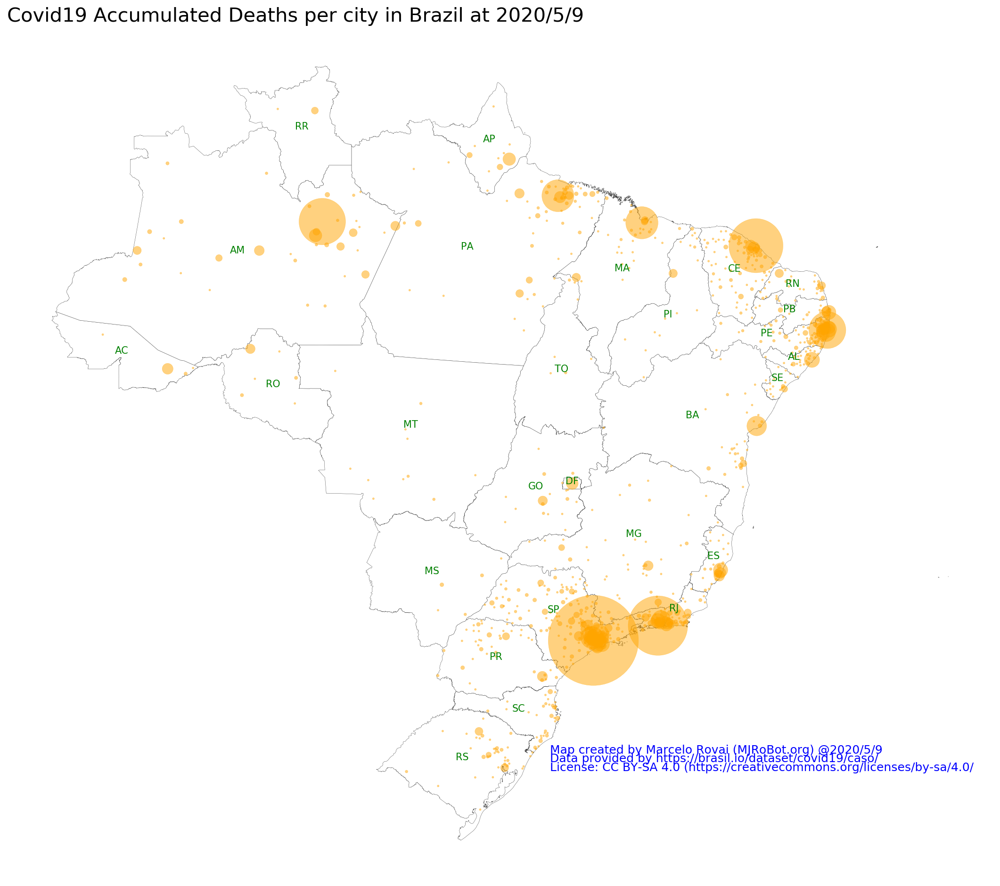

In [184]:
plt_Brasil_cv_metrics(cv_city_pnt, deaths_city_pnt, date, total_cases,
                      deaths, cfr, br_shp, br_cities, metrics='deaths', n=4)

**WARNING** 

Position of annotation in final saved figures is different from the ones showed at Notebook

## Other Pandemic metrics maps

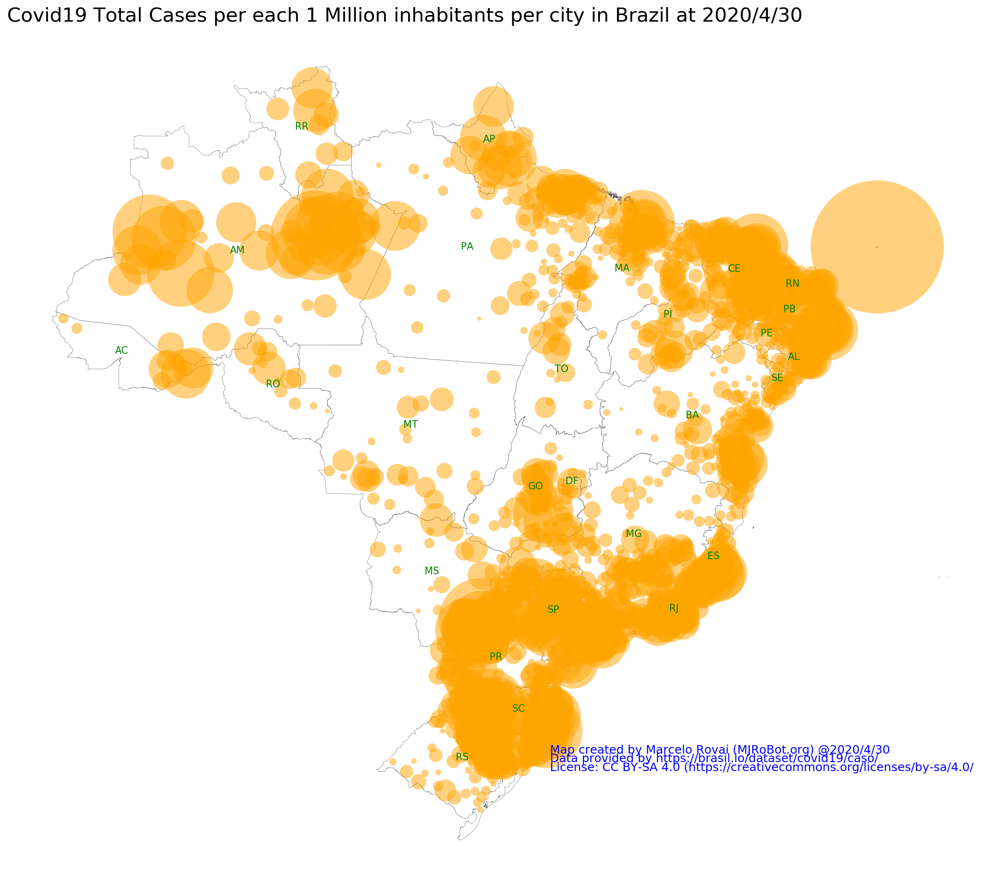

In [15]:
plt_Brasil_cv_metrics(cv_city_pnt, deaths_city_pnt, date, total_cases, deaths, cfr, br_shp, br_cities, metrics='TotalCases/1M pop', n=2 )

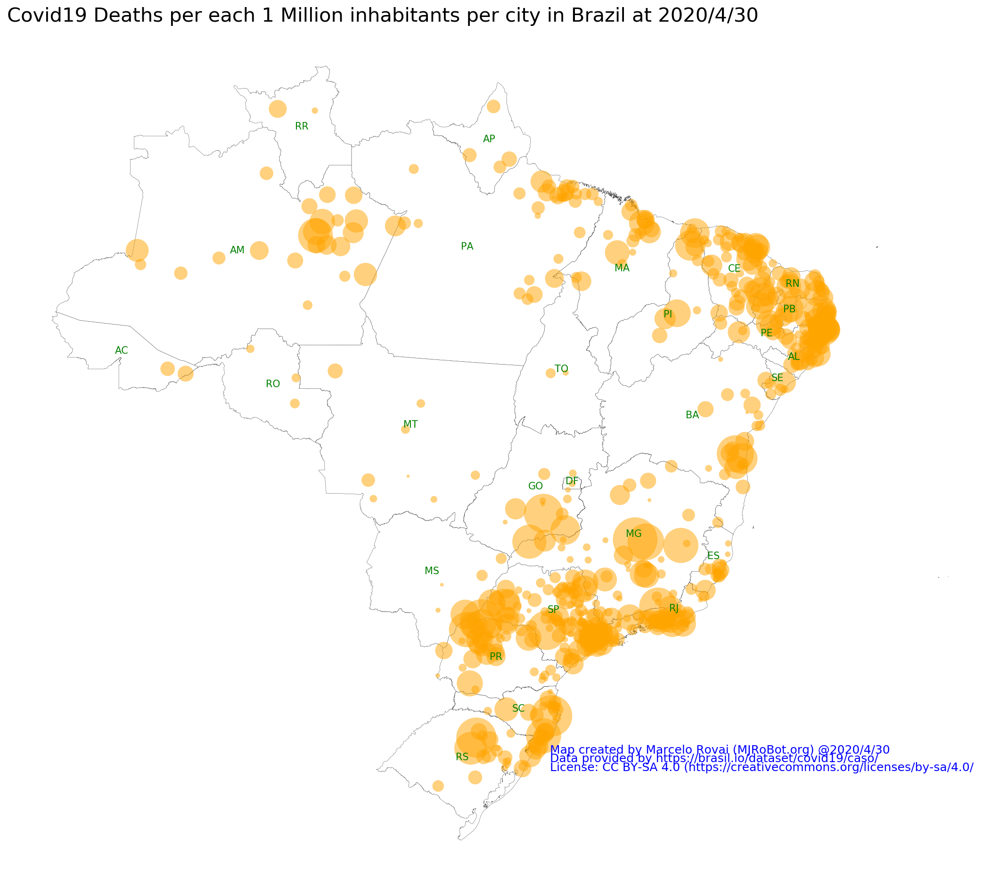

In [16]:
plt_Brasil_cv_metrics(cv_city_pnt, deaths_city_pnt, date, total_cases, deaths, cfr, br_shp, br_cities, metrics='Deaths/1M pop', n=5 )

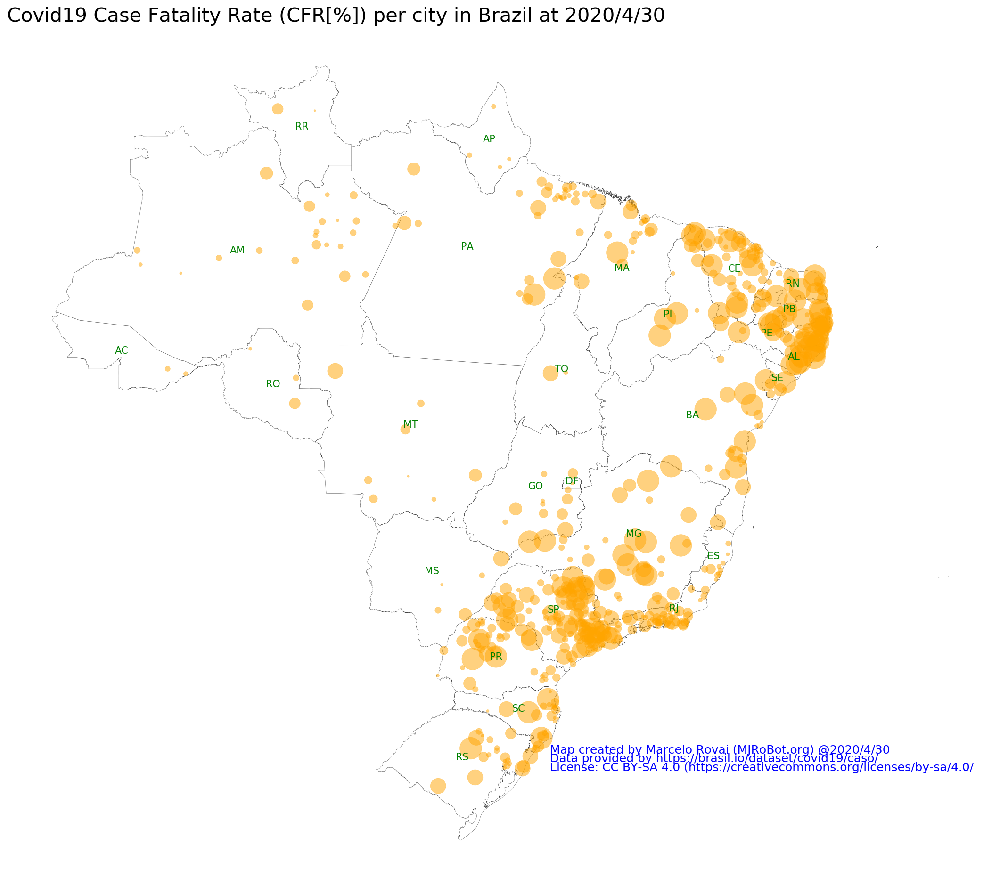

In [17]:
plt_Brasil_cv_metrics(cv_city_pnt, deaths_city_pnt, date, total_cases, deaths, cfr, br_shp, br_cities, metrics='CFR[%]', n=5 )

### Selected State Analysis

Total number of Covid19 cases reported in SP State at 4/30: 28,698 (2,247 fatal) in 315 specified cities


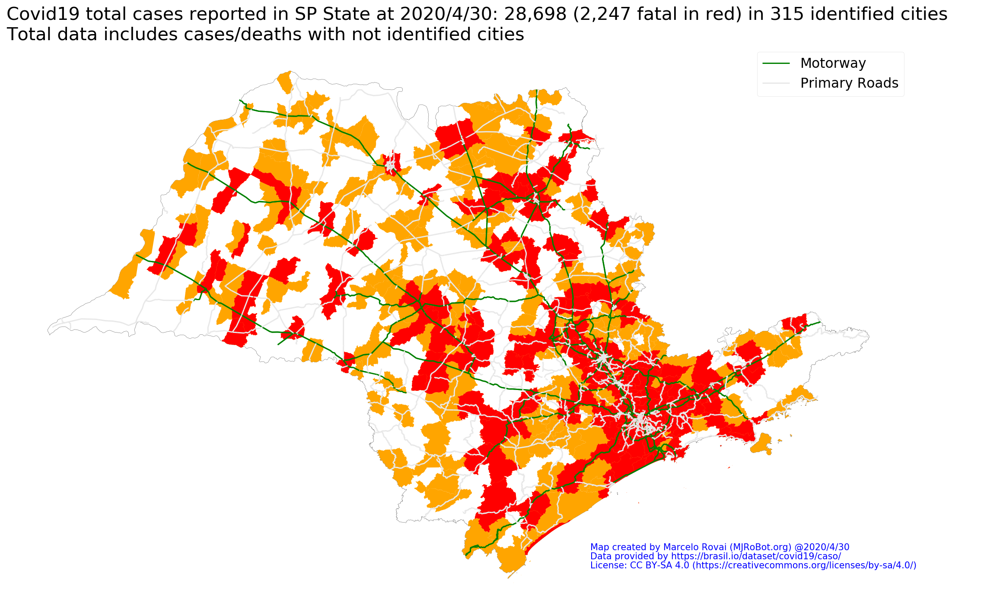

In [18]:
cv_sp, deaths_sp, sp_total_cases, sp_deaths = get_state_info(cv_city, dt_state, br_shp, br_cities, 'SP')

Total number of Covid19 cases reported in RJ State at 4/30: 8,869 (794 fatal) in 80 specified cities
Total number of Covid19 cases reported in MG State at 4/30: 1,827 (80 fatal) in 175 specified cities
Total number of Covid19 cases reported in CE State at 4/30: 7,532 (450 fatal) in 144 specified cities


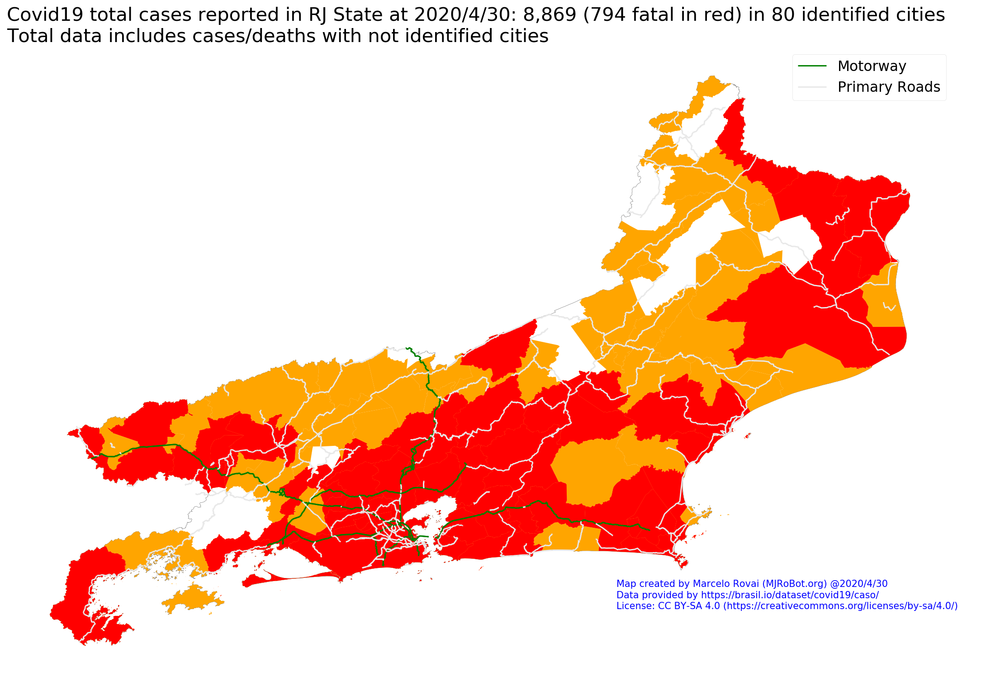

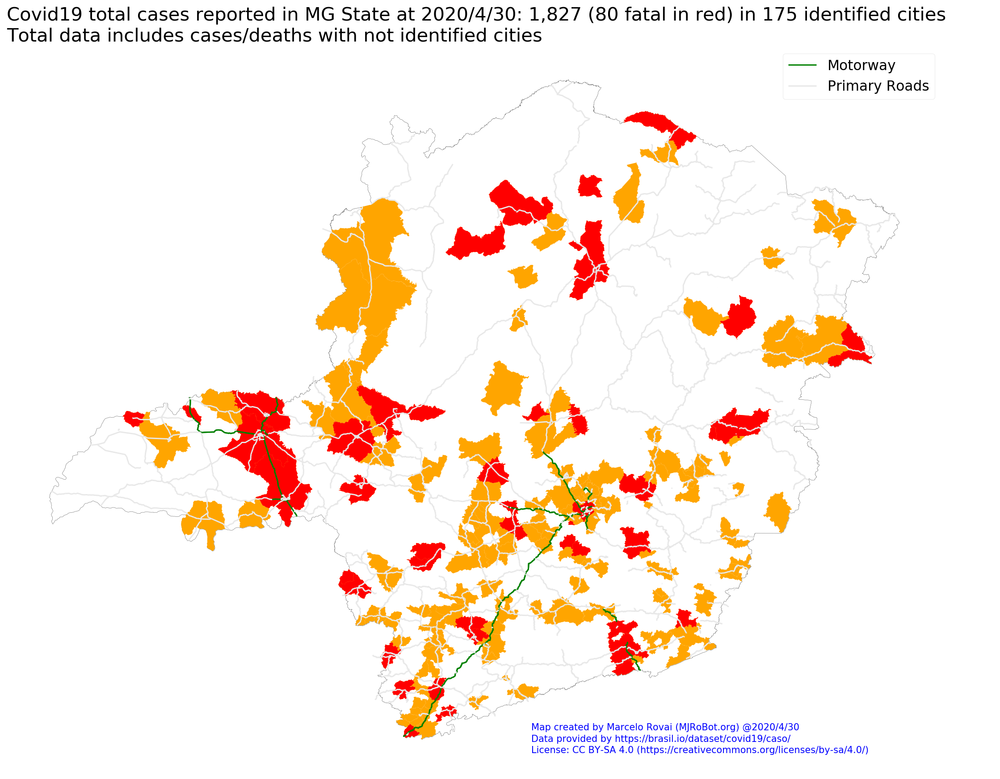

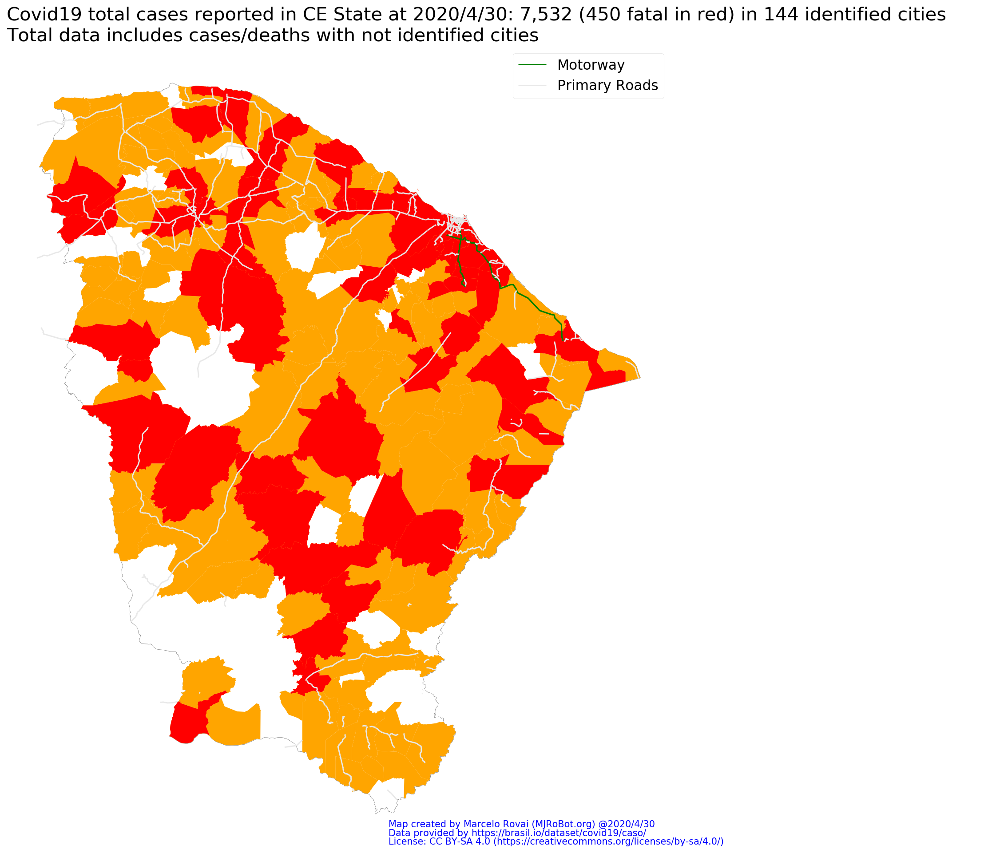

In [19]:
cv_rj, deaths_rj, rj_total_cases, rj_deaths = get_state_info(cv_city, dt_state, br_shp, br_cities, 'RJ')
cv_mg, deaths_mg, mg_total_cases, mg_deaths = get_state_info(cv_city, dt_state, br_shp, br_cities, 'MG')
cv_ce, deaths_ce, ce_total_cases, ce_deaths = get_state_info(cv_city, dt_state, br_shp, br_cities, 'CE')

## Creating  Gifs / Movies 

### Creating Gifs
 - https://github.com/imageio/imageio

In [20]:
cv_city_t = pd.merge(br_cities, dt_tm_city, on='COD. IBGE')
deaths_city_t = cv_city_t.loc[cv_city_t['deaths'] != 0].copy()
dates = list(set(cv_city_t.date))
dates.sort()

In [21]:
 dates = dates[-2:]

In [22]:
# For updating after first time
dates

['2020-04-29', '2020-04-30']

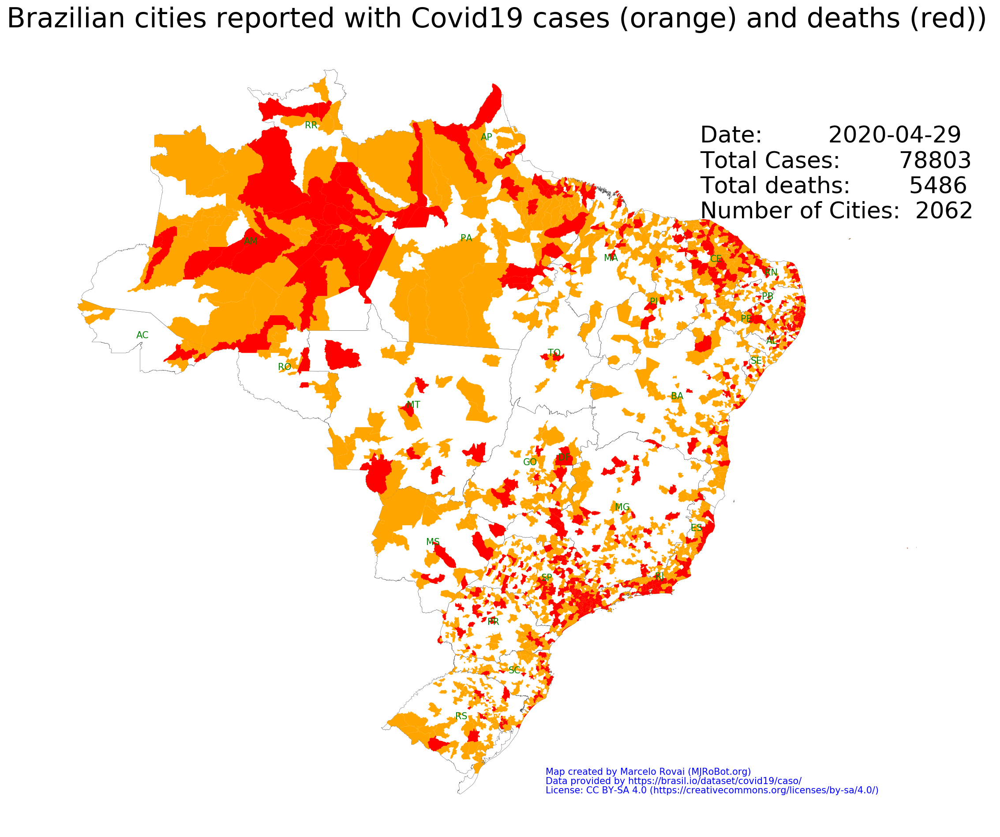

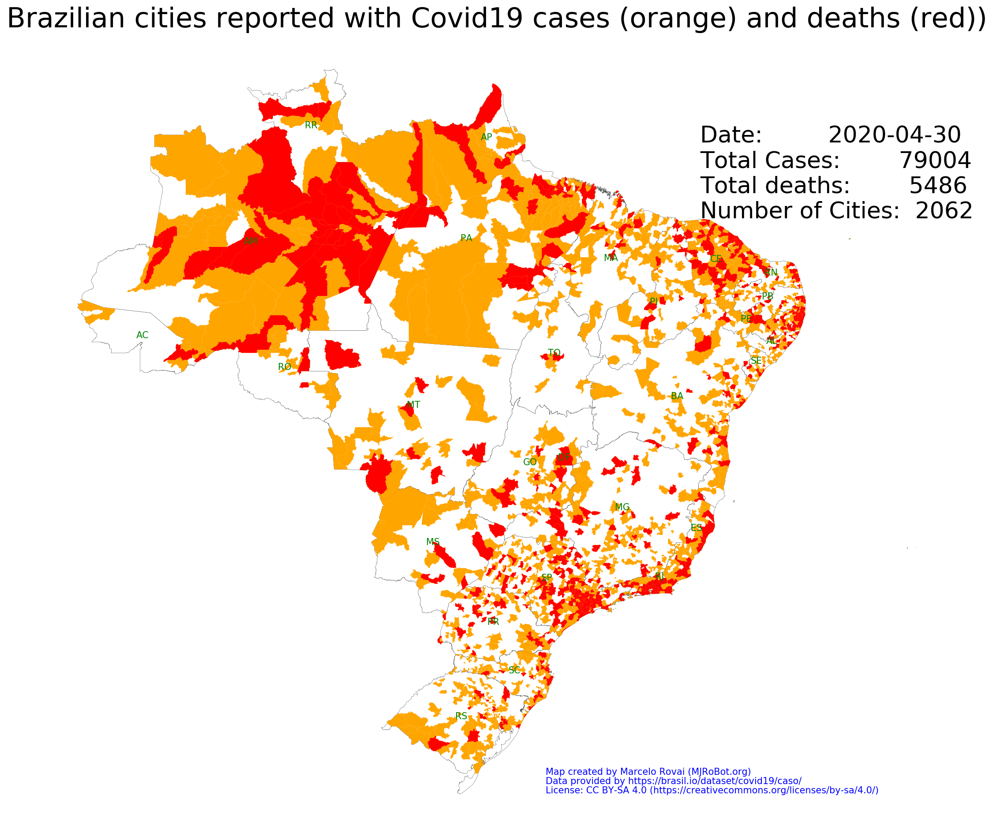

In [23]:
create_state_gif(dates, cv_city_t, deaths_city_t, br_shp, 'BR')

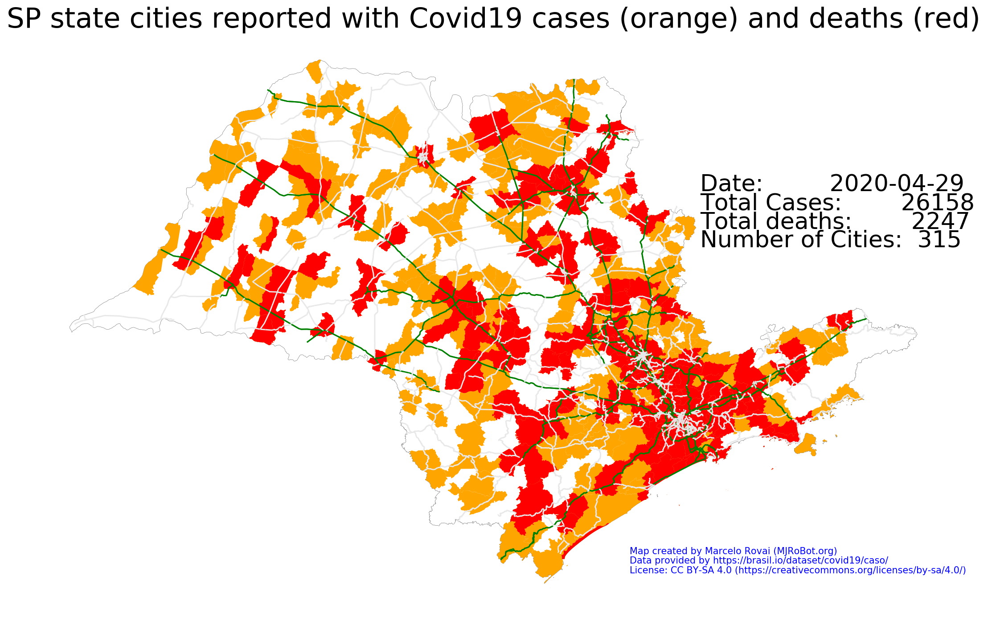

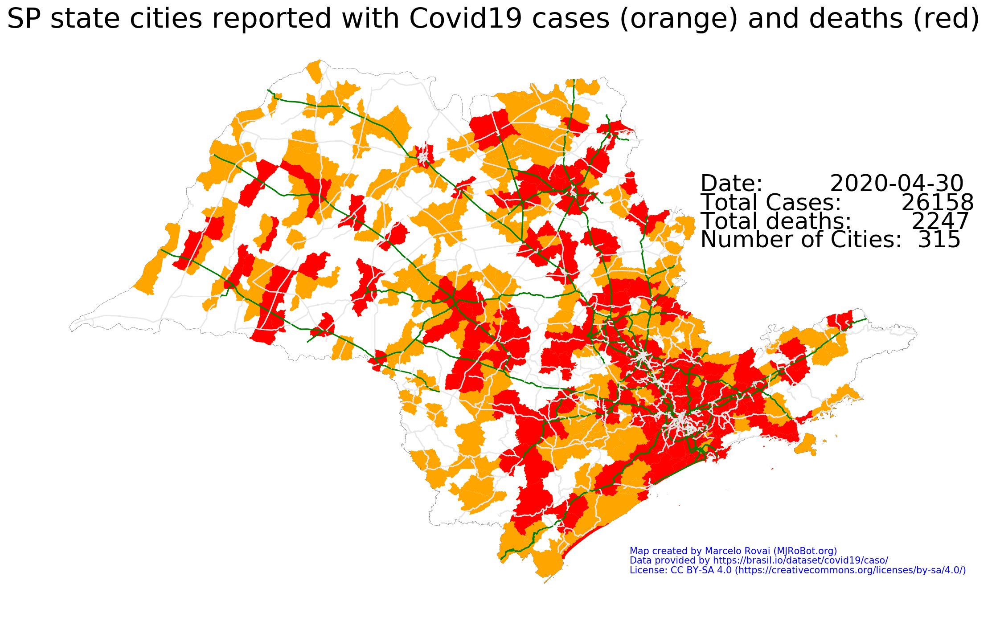

In [24]:
create_state_gif(dates, cv_city_t, deaths_city_t, br_shp, 'SP')

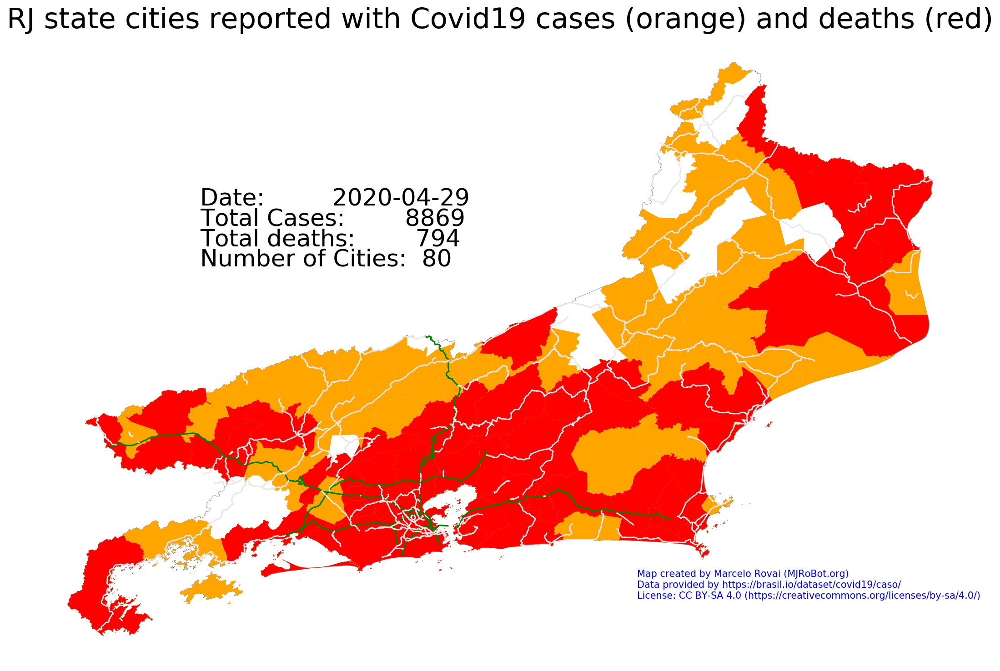

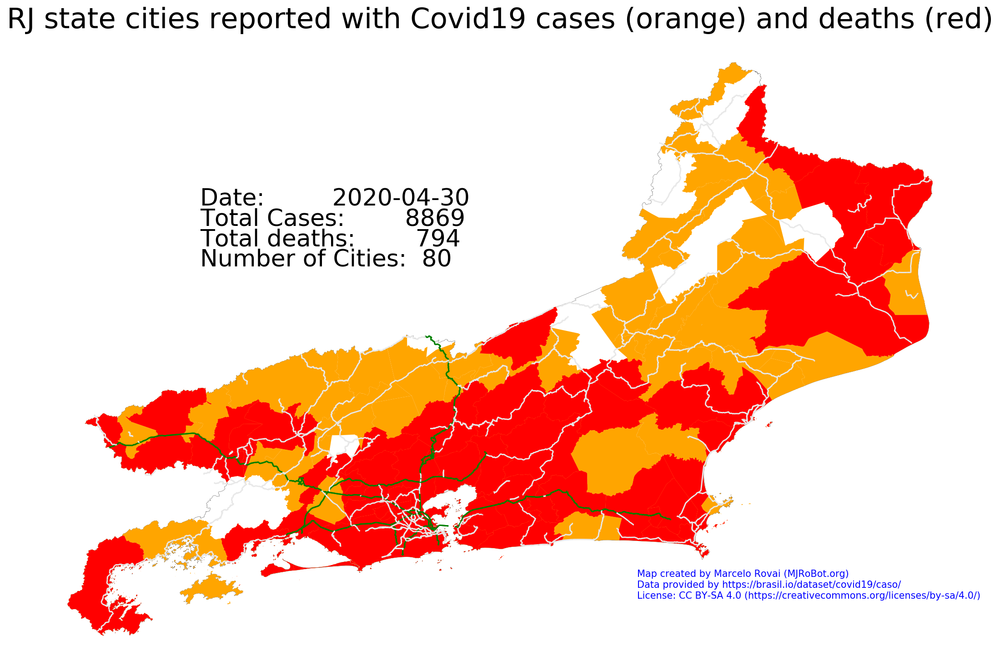

In [25]:
create_state_gif(dates, cv_city_t, deaths_city_t, br_shp, 'RJ')

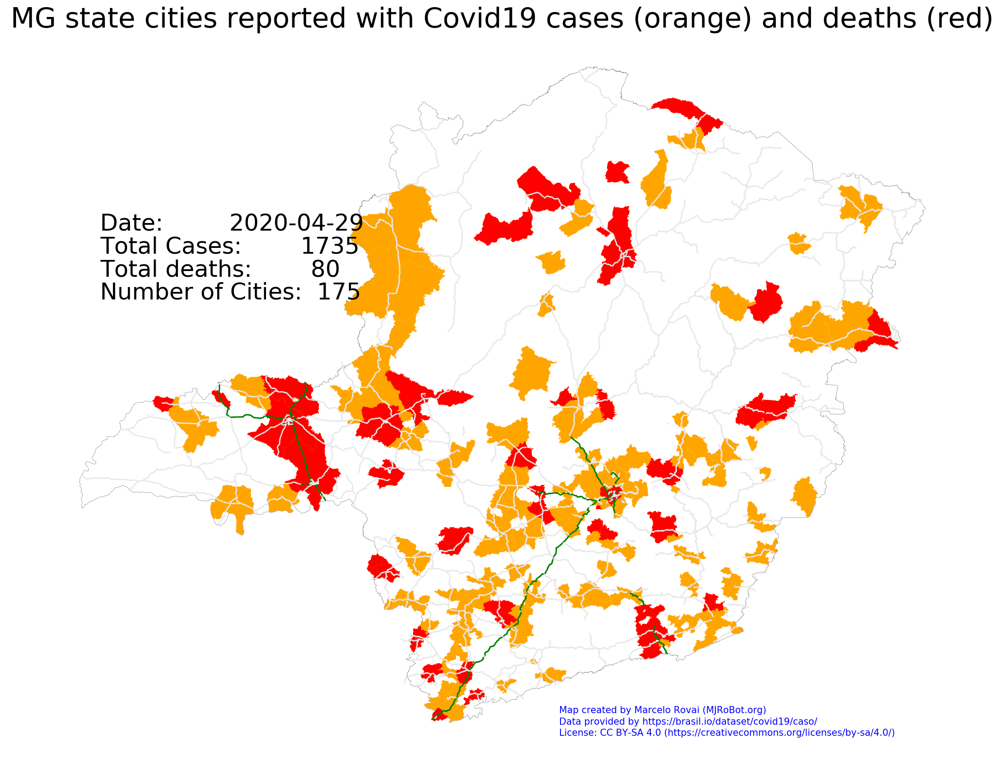

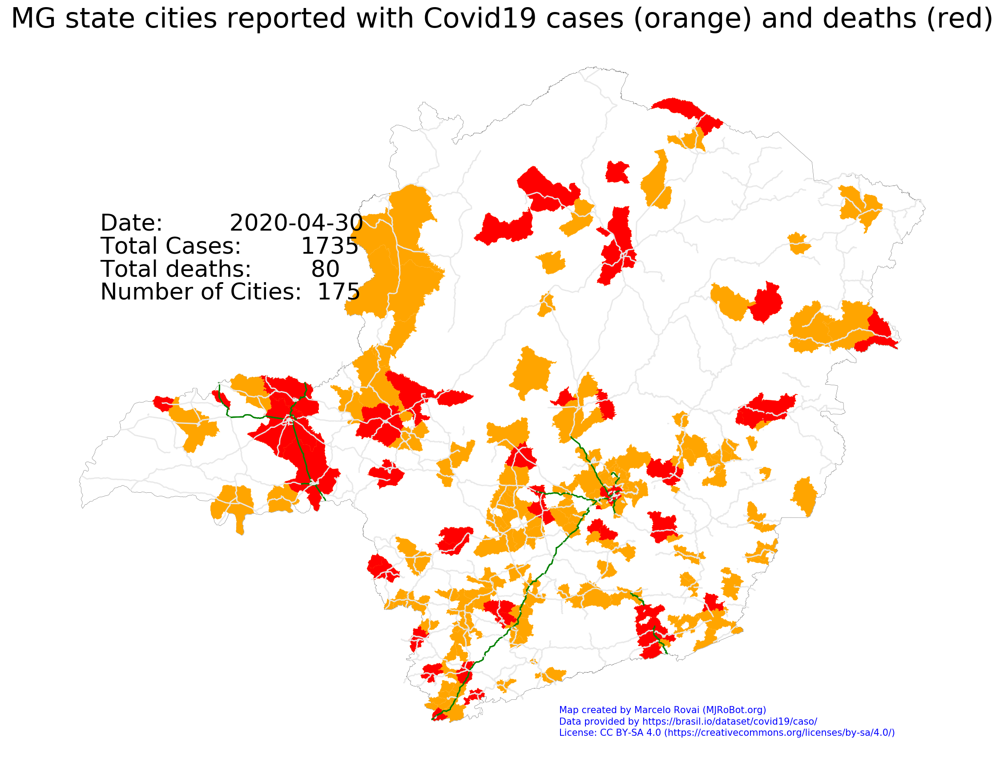

In [26]:
create_state_gif(dates, cv_city_t, deaths_city_t, br_shp, 'MG')

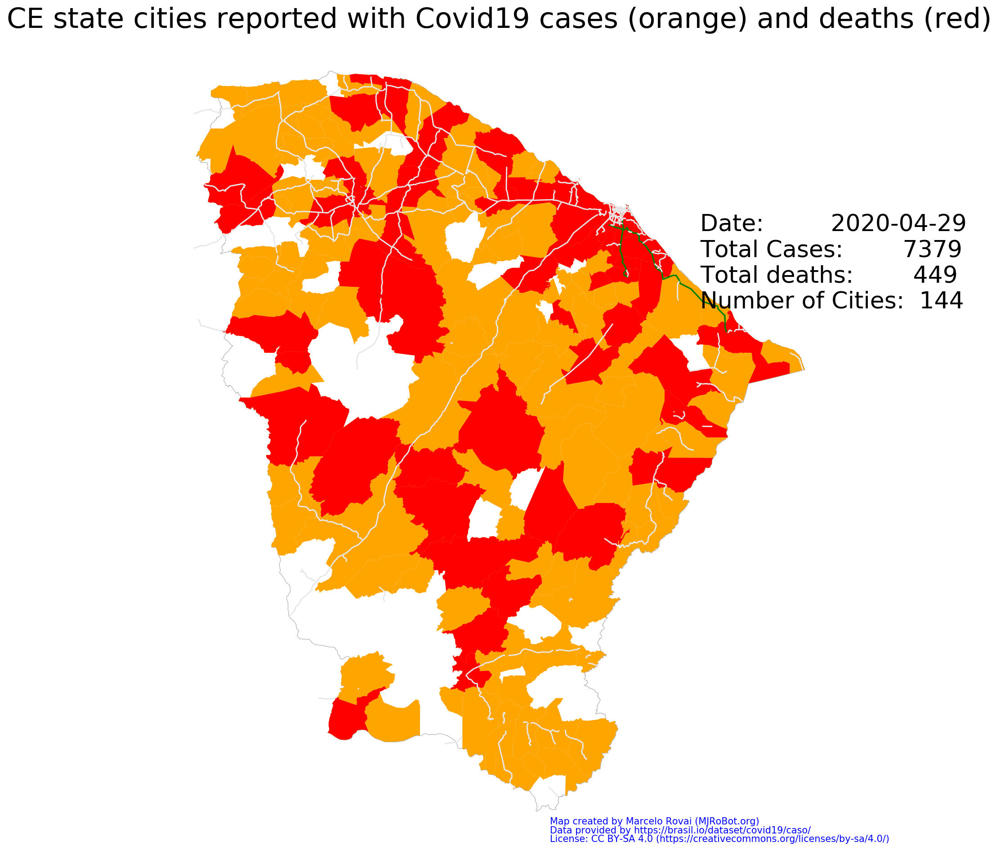

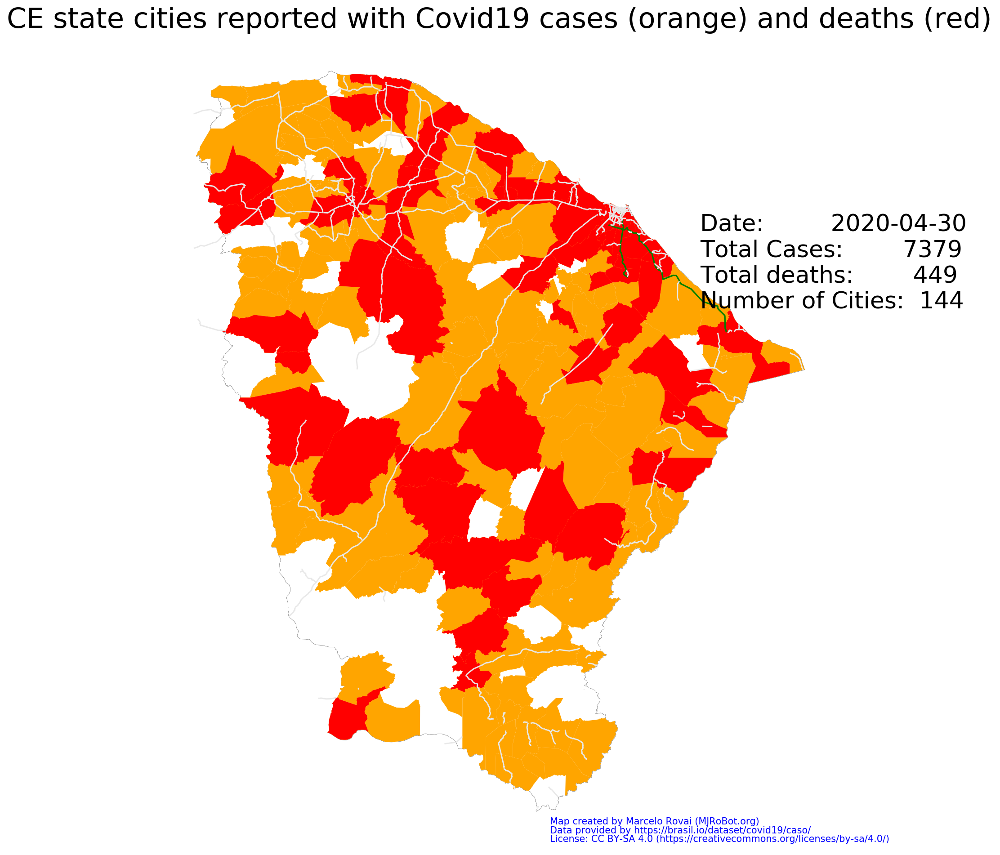

In [27]:
create_state_gif(dates, cv_city_t, deaths_city_t, br_shp, 'CE')

### Creating videos from Gifs

In [28]:
print ('\n[INFO] Creating Movies - WAIT ', end =" ")        
### Creating videos from Gifs

conv_gif_to_mp4('BR', fps=5); print ('.', end =" ") 
conv_gif_to_mp4('SP', fps=5); print ('.', end =" ") 
conv_gif_to_mp4('RJ', fps=5); print ('.', end =" ") 
conv_gif_to_mp4('MG', fps=5); print ('.', end =" ") 
conv_gif_to_mp4('CE', fps=5); print ('.', end =" ") 

print ('\n[INFO] End script MJRoBot.org @ {}\n'.format(today)) 


[INFO] Creating Movies - WAIT  . . . . . 
[INFO] End script MJRoBot.org @ 2020-04-30 12:45:05.028314

